# Ejemplo de análisis con pandas, geopandas y folium

Se presenta un ejemplo de análisis [reproducible](https://es.wikipedia.org/wiki/Reproducibilidad_y_repetibilidad) de datos geoespaciales: la distribución de especies de murciélagos en áreas silvestres protegidas (ASP) de Costa Rica.

Las salidas se presentan en tres formatos:

- Tabular
- Gráfica
- Geoespacial

El ćodigo fuente de este ejercicio está disponible en [https://github.com/pf3311-cienciadatosgeoespaciales/2021-iii/blob/main/contenido/b/ejemplo-analisis-pandas-geopandas-folium.ipynb](https://github.com/pf3311-cienciadatosgeoespaciales/2021-iii/blob/main/contenido/b/ejemplo-analisis-pandas-geopandas-folium.ipynb). 

Las salidas puede ser visualizadas en [https://nbviewer.org/github/pf3311-cienciadatosgeoespaciales/2021-iii/blob/main/contenido/b/ejemplo-analisis-pandas-geopandas-folium.ipynb](https://nbviewer.org/github/pf3311-cienciadatosgeoespaciales/2021-iii/blob/main/contenido/b/ejemplo-analisis-pandas-geopandas-folium.ipynb).

Para más información sobre investigación reproducible en datos geoespaciales, se recomienda ver [FOSS4G2021 - Open source for open spatial data science](https://www.youtube.com/watch?v=ZjXb53pOor0).

## Entradas

### Registros de presencia de murciélagos

Provienen de una [consulta](https://doi.org/10.15468/dl.kj2qnn) al portal de la [Infraestructura Mundial de Información en Biodiversidad (GBIF)](https://www.gbif.org/).

Para efectos de este análisis, están disponibles en [https://raw.githubusercontent.com/pf3311-cienciadatosgeoespaciales/2021-iii/main/contenido/b/datos/murcielagos.csv](https://raw.githubusercontent.com/pf3311-cienciadatosgeoespaciales/2021-iii/main/contenido/b/datos/murcielagos.csv).

### Polígonos de áreas silvestres protegidas (ASP)

Fueron publicados por el [Sistema Nacional de Áreas de Conservación (Sinac)](http://www.sinac.go.cr/) a través del [Sistema Nacional de Información Territorial (SNIT)](https://www.snitcr.go.cr/), en [http://geos1pne.sirefor.go.cr/wfs?](http://geos1pne.sirefor.go.cr/wfs?).

Para efectos de este análisis, están disponibles en [https://github.com/pf3311-cienciadatosgeoespaciales/2021-iii/blob/main/contenido/b/datos/asp.geojson](https://github.com/pf3311-cienciadatosgeoespaciales/2021-iii/blob/main/contenido/b/datos/asp.geojson).

## Procesamiento

In [1]:
import math

import pandas as pd

import matplotlib.pyplot as plt
%matplotlib inline

import plotly.express as px

import geopandas as gpd

import folium
from folium import Marker
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap

### Lectura de datos

**Registros de presencia de murciélagos**

In [2]:
# Carga de registros de presencia de murciélagos en un dataframe de pandas

murcielagos = pd.read_csv("https://raw.githubusercontent.com/pf3311-cienciadatosgeoespaciales/2021-iii/main/contenido/b/datos/murcielagos.csv", 
                          sep="\t")

murcielagos

,gbifID,datasetKey,occurrenceID,kingdom,phylum,class,order,family,genus,species,...,identifiedBy,dateIdentified,license,rightsHolder,recordedBy,typeStatus,establishmentMeans,lastInterpreted,mediaType,issue
0,3416142999,50c9509d-22c7-4a22-a47d-8c48425ef4a7,https://www.inaturalist.org/observations/10118...,Animalia,Chordata,Mammalia,Chiroptera,Vespertilionidae,Rhogeessa,Rhogeessa io,...,Yuzefovich Alexander,2021-11-15T14:33:49,CC_BY_NC_4_0,jo22nfrog,jo22nfrog,NaN,NaN,2021-12-08T05:34:32.772Z,StillImage,COORDINATE_ROUNDED
1,3416092578,50c9509d-22c7-4a22-a47d-8c48425ef4a7,https://www.inaturalist.org/observations/10131...,Animalia,Chordata,Mammalia,Chiroptera,Phyllostomidae,Uroderma,Uroderma bilobatum,...,Merav Vonshak,2021-11-17T06:37:32,CC_BY_NC_4_0,Merav Vonshak,Merav Vonshak,NaN,NaN,2021-12-08T06:09:54.326Z,StillImage,COORDINATE_ROUNDED
2,3415771696,50c9509d-22c7-4a22-a47d-8c48425ef4a7,https://www.inaturalist.org/observations/88766024,Animalia,Chordata,Mammalia,Chiroptera,Phyllostomidae,Artibeus,Artibeus jamaicensis,...,Yuzefovich Alexander,2021-07-27T06:38:03,CC_BY_NC_4_0,Alex Castelein,Alex Castelein,NaN,NaN,2021-12-08T05:05:13.398Z,StillImage,COORDINATE_ROUNDED
3,3415765386,50c9509d-22c7-4a22-a47d-8c48425ef4a7,https://www.inaturalist.org/observations/36722404,Animalia,Chordata,Mammalia,Chiroptera,Phyllostomidae,Uroderma,Uroderma bilobatum,...,Jay,2019-12-17T22:12:20,CC_BY_NC_4_0,Jay,Jay,NaN,NaN,2021-12-08T04:59:02.428Z,StillImage,COORDINATE_ROUNDED
4,3415753400,50c9509d-22c7-4a22-a47d-8c48425ef4a7,https://www.inaturalist.org/observations/39440952,Animalia,Chordata,Mammalia,Chiroptera,Emballonuridae,Rhynchonycteris,Rhynchonycteris naso,...,Jakob Fahr,2020-03-02T08:06:42,CC_BY_NC_4_0,Ben Zerante,Ben Zerante,NaN,NaN,2021-12-08T05:48:47.800Z,StillImage,COORDINATE_ROUNDED
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13184,45849434,847e2306-f762-11e1-a439-00145eb45e9a,urn:catalog:LSUMZ:Mammals:12726,Animalia,Chordata,Mammalia,Chiroptera,Phyllostomidae,Anoura,Anoura geoffroyi,...,NaN,NaN,CC0_1_0,NaN,"Gardner, Alfred L.",NaN,NATIVE,2021-12-02T03:54:15.435Z,NaN,INSTITUTION_COLLECTION_MISMATCH
13185,45849433,847e2306-f762-11e1-a439-00145eb45e9a,urn:catalog:LSUMZ:Mammals:12725,Animalia,Chordata,Mammalia,Chiroptera,Phyllostomidae,Anoura,Anoura geoffroyi,...,NaN,NaN,CC0_1_0,NaN,"Gardner, Alfred L.",NaN,NATIVE,2021-12-02T03:54:15.435Z,NaN,INSTITUTION_COLLECTION_MISMATCH
13186,45849432,847e2306-f762-11e1-a439-00145eb45e9a,urn:catalog:LSUMZ:Mammals:12724,Animalia,Chordata,Mammalia,Chiroptera,Phyllostomidae,Anoura,Anoura geoffroyi,...,NaN,NaN,CC0_1_0,NaN,"Gardner, Alfred L.",NaN,NATIVE,2021-12-02T03:54:15.437Z,NaN,INSTITUTION_COLLECTION_MISMATCH
13187,45849431,847e2306-f762-11e1-a439-00145eb45e9a,urn:catalog:LSUMZ:Mammals:12723,Animalia,Chordata,Mammalia,Chiroptera,Phyllostomidae,Anoura,Anoura geoffroyi,...,NaN,NaN,CC0_1_0,NaN,"Gardner, Alfred L.",NaN,NATIVE,2021-12-02T03:54:15.436Z,NaN,INSTITUTION_COLLECTION_MISMATCH


**Polígonos de ASP**

In [3]:
# Carga de registros de presencia de murciélagos en un dataframe de pandas

asp = gpd.read_file("https://github.com/pf3311-cienciadatosgeoespaciales/2021-iii/raw/main/contenido/b/datos/asp.geojson")

asp

,id,codigo,nombre_asp,cat_manejo,estatus,siglas_cat,nombre_ac,siglas_ac,descripcio,a_creacion,n_creacion,normativa,area,area_km,version,geometry
0,areas_silvestres_protegidas.1,A01,Montes Submarinos,Area Marina de Manejo,Estatal,AMM,Marina Cocos,ACMC,Area Marina de Manejo,2011,DE_36452,None,9.592623e+09,9.592623e+07,2019-11-19-001,"POLYGON ((-87.00000 6.13333, -86.43333 5.73333..."
1,areas_silvestres_protegidas.2,A02,Cabo Blanco,Area Marina de Manejo,Estatal,AMM,Area de Conservacion Tempisque,ACT,Area Marina de Manejo,1963,Ley_10,None,8.247806e+08,8.247806e+06,2019-11-19-001,"POLYGON ((-85.14336 9.59649, -85.14332 9.59643..."
2,areas_silvestres_protegidas.3,B01,Alberto Manuel Brenes,Reserva Biologica,Estatal,RB,Area de Conservacion Central,ACC,Area terrestre protegida,1993,Ley_7354,None,7.800440e+07,7.800440e+05,2019-11-19-001,"POLYGON ((-84.63388 10.18202, -84.64167 10.177..."
3,areas_silvestres_protegidas.4,B03,Isla Guayabo,Reserva Biologica,Estatal,RB,Area de Conservacion Tempisque,ACT,Isla,1973,DE_2858_A,None,6.268092e+04,6.268092e+02,2019-11-19-001,"POLYGON ((-84.87710 9.91109, -84.87737 9.91086..."
4,areas_silvestres_protegidas.5,B04,Isla Pajaros,Reserva Biologica,Estatal,RB,Area de Conservacion Pacifico Central,ACOPAC,Isla,1976,DE_ 5963_A,None,3.211583e+04,3.211583e+02,2019-11-19-001,"POLYGON ((-84.99674 10.09266, -84.99696 10.092..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,areas_silvestres_protegidas.168,Z31,Quebrada Rosario,Zona Protectora,Estatal,ZP,Area de Conservacion Central,ACC,Area terrestre protegida,1997,DE_ 26297_MINAE,None,4.292695e+05,4.292695e+03,2019-11-19-001,"POLYGON ((-84.07619 9.70425, -84.07689 9.70374..."
168,areas_silvestres_protegidas.169,P10,Santa Rosa,Parque Nacional,Estatal,PN,Area de Conservacion Guanacaste,ACG,Isla,1966,Ley_3694,None,3.230258e+06,3.230258e+04,2019-11-19-001,"MULTIPOLYGON (((-85.87565 10.84304, -85.87571 ..."
169,areas_silvestres_protegidas.170,V25,Bahia Junquillal,Refugio Nacional de Vida Silvestre,Estatal,RVS,Area de Conservacion Guanacaste,ACG,Isla,1995,DE_ 23867_MIRENEM,None,1.836792e+05,1.836792e+03,2021-08-20-001,"MULTIPOLYGON (((-85.73360 10.95775, -85.73329 ..."
170,areas_silvestres_protegidas.171,P18,Internacional La Amistad,Parque Nacional,Estatal,PN,Area de Conservacion La Amistad Pacifico,ACLAP,Area terrestre protegida,1982,DE_13324_A,None,1.982896e+09,1.982896e+07,2019-11-19-001,"MULTIPOLYGON (((-82.85282 9.01273, -82.85414 9..."


### Visualización preliminar

**Mapa interactivo de puntos agrupados (*clusters*)**

In [4]:
# Creación del mapa base
m = folium.Map(location=[9.6, -84.2], tiles='CartoDB positron', zoom_start=8)


# Capa de ASP
folium.GeoJson(data="https://github.com/pf3311-cienciadatosgeoespaciales/2021-iii/raw/main/contenido/b/datos/asp.geojson", 
               name="ASP").add_to(m)


# Capa de registros de presencia de murciélagos agrupados
mc = MarkerCluster()
for idx, row in murcielagos.iterrows():
    if not math.isnan(row['decimalLongitude']) and not math.isnan(row['decimalLatitude']):
        mc.add_child(Marker([row['decimalLatitude'], row['decimalLongitude']], popup=row['species']))
m.add_child(mc)

# Control de capas
folium.LayerControl().add_to(m)

# Despliegue del mapa
m

**Mapa interactivo de calor (*heatmap*)**

In [5]:
# Creación del mapa base
m = folium.Map(location=[9.6, -84.2], tiles='CartoDB dark_matter', zoom_start=8)


# Capa de ASP
folium.GeoJson(data="https://github.com/pf3311-cienciadatosgeoespaciales/2021-iii/raw/main/contenido/b/datos/asp.geojson", 
               name="ASP").add_to(m)


# Capa de calor de registros de presencia de murciélagos
HeatMap(data=murcielagos[['decimalLatitude', 'decimalLongitude']], radius=10).add_to(m)

# Control de capas
folium.LayerControl().add_to(m)

# Despliegue del mapa
m

### Cálculo de la cantidad de especies por ASP

**Conversión del dataframe de murciélagos a geodataframe**

In [6]:
murcielagos = gpd.GeoDataFrame(murcielagos, 
                               geometry=gpd.points_from_xy(murcielagos.decimalLongitude, murcielagos.decimalLatitude))

In [7]:
# Join espacial de las capas de ASP y registros de presencia de murciélagos

asp_contienen_murcielagos = asp.sjoin(murcielagos, how="left", op="contains")

# Conteo de especies en cada ASP
asp_especies = asp_contienen_murcielagos.groupby("id").species.nunique()
asp_especies = asp_especies.reset_index() # para convertir la serie a dataframe

asp_especies.rename(columns = {'species': 'cantidad_especies_murcielagos'}, inplace = True)

asp_especies

/home/mfvargas/miniconda3/envs/pf3311/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3457: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
/home/mfvargas/miniconda3/envs/pf3311/lib/python3.10/site-packages/geopandas/geodataframe.py:1938: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: None

  return geopandas.sjoin(left_df=self, right_df=df, *args, **kwargs)


,id,cantidad_especies_murcielagos
0,areas_silvestres_protegidas.1,0
1,areas_silvestres_protegidas.10,0
2,areas_silvestres_protegidas.100,0
3,areas_silvestres_protegidas.101,2
4,areas_silvestres_protegidas.102,0
...,...,...
167,areas_silvestres_protegidas.95,1
168,areas_silvestres_protegidas.96,0
169,areas_silvestres_protegidas.97,0
170,areas_silvestres_protegidas.98,1


## Salidas

### Tabular

In [8]:
# Join para agregar la columna con el conteo a la capa de ASP
asp_especies = asp_especies.join(asp.set_index('id'), on='id', rsuffix='_b')

asp_especies[["nombre_asp", "cantidad_especies_murcielagos"]].sort_values("cantidad_especies_murcielagos", ascending=[False])

,nombre_asp,cantidad_especies_murcielagos
51,Golfo Dulce,54
25,Arenal Monteverde,31
111,Palo Verde,29
5,La Selva,27
129,Barra del Colorado,27
...,...,...
56,Humedal Laguna Madrigal,0
55,Rio Oro,0
54,Preciosa Platanares,0
53,Punta Rio Claro,0


### Gráfica

Se presentan salidas de gráficos estadísticos en [Matplotlib]() y [plotly]().

In [9]:
# Dataframe filtrado para usar en graficación
asp_especies_grafico = asp_especies[["nombre_asp", "cantidad_especies_murcielagos"]].sort_values("cantidad_especies_murcielagos", ascending=[False]).head(15)

**Matplotlib**

Text(0, 0.5, 'Cantidad de especies')

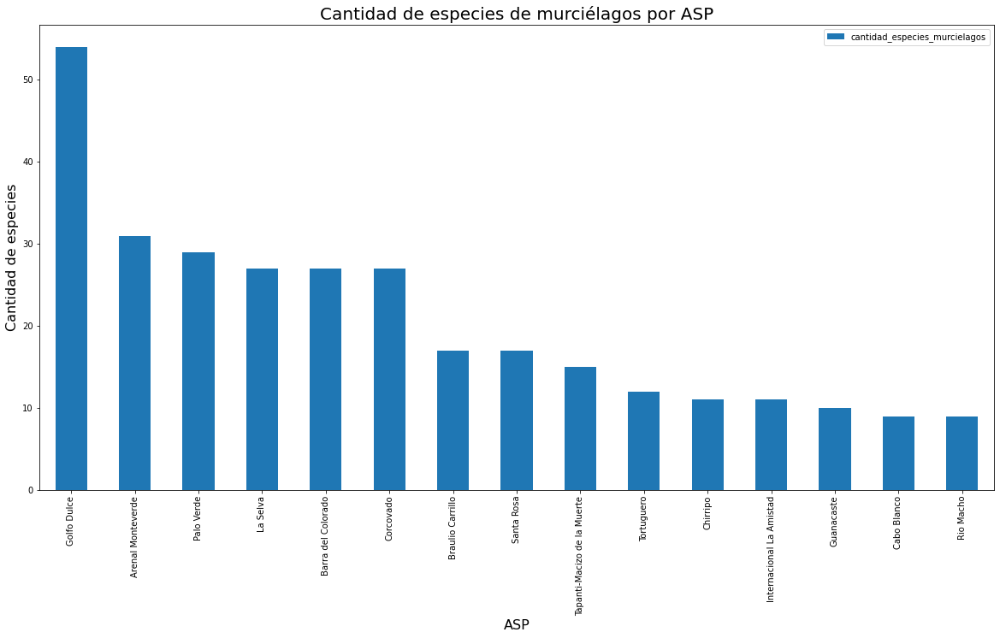

In [10]:
# Graficación
asp_especies_grafico.plot(x='nombre_asp', 
                          y='cantidad_especies_murcielagos', 
                          kind='bar', 
                          figsize=(20,10))

# Título y leyendas en los ejes
plt.title('Cantidad de especies de murciélagos por ASP', fontsize=20)
plt.xlabel('ASP', fontsize=16)
plt.ylabel('Cantidad de especies', fontsize=16)

**plotly**

In [11]:
fig = px.bar(asp_especies_grafico, 
             x='nombre_asp', 
             y='cantidad_especies_murcielagos', 
             labels={'nombre_asp':'ASP', 'cantidad_especies_murcielagos':'Cantidad de especies'},
             title="Cantidad de especies de murciélagos por ASP")

fig.show()

Para más información sobre plotly, se recomienda ver [Data Visualization as The First and Last Mile of Data Science Plotly Express and Dash | SciPy 2021](https://www.youtube.com/watch?v=FpCgG85g2Hw).

### Geoespacial

In [12]:
# Creación del mapa base
m = folium.Map(location=[9.8, -84], tiles='CartoDB positron', zoom_start=8)

folium.Choropleth(
    name="Cantidad de especies en ASP",
    geo_data=asp,
    data=asp_especies,
    columns=['id', 'cantidad_especies_murcielagos'],
    bins=8,
    key_on='feature.properties.id',
    fill_color='Reds', 
    fill_opacity=0.5, 
    line_opacity=1,
    legend_name='Cantidad de especies de murciélagos',
    smooth_factor=0).add_to(m)

# Control de capas
folium.LayerControl().add_to(m)

# Despliegue del mapa
m